<a href="https://colab.research.google.com/github/Kyrylo-Bakumenko/Encoder-Decoder-for-Hidden-Images/blob/main/hidden_image_encoder.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [66]:
import PIL
import matplotlib.pyplot as plt
import cv2
from google.colab.patches import cv2_imshow

Let's just make sure evrything loads properly and that we understand what is length and width for our images.

Helper Methods:

In [67]:
# Returns true if the given value is even, false otherwise
def isEven(value):
    return value % 2 == 0

# Given a number, return the lowest bit in the binary representation
# of the number.
# Returns either a 0 or a 1  
def getLowestBit(value):
    return value % 2

# Given a number, return a new number with the same underlying bits
# except the lowest bit is set to the given bitValue.

def setLowestBit(value, bitValue):
    if(not isEven(value - bitValue)):
        return value + 2*isEven(value) - 1
    return value

# Encodes the given secret pixel into the low bits of the
# RGB values of the given cover pixel
# Returns the modified cover pixel

def encodePixel(coverPixel, secretPixel):
    for i in range(0, 3):
        coverPixel[i] = setLowestBit(coverPixel[i], secretPixel[i] > 127)
    return coverPixel

# Extracts the RGB values for a secret pixel from the low bits
# of the given cover pixel
# Returns the resulting secret pixel

def decodePixel(coverPixel):
    secretPixel = [0, 0, 0]
    for i in range(0, 3):
        secretPixel[i] = getLowestBit(coverPixel[i])*255;
    return secretPixel

Encoder Method

In [68]:
def encoder(target, cover, step = 1):

  tg_height = len(target) #target image height
  tg_width = len(target[0]) #target image width
  cv_height = len(cover) #cover image height
  cv_width = len(cover[0]) #cover image width

  if tg_height/step <= cv_height/step or tg_width/step <= cv_width/step: #checks if there are size mismatches
    for row in range(0, tg_height, step):
      for col in range(0, tg_width, step):
        cover[row][col] = encodePixel(cover[row][col], target[row][col])
    return cover
  else:
    print(f'Shortening target by {step + 1} times') #lets user know of compression
    return encoder(target, cover, step + 1) #makes a compressed call

Decoder Method

In [69]:
def decoder(target):

  tg_height = len(target) #target image height
  tg_width = len(target[0]) #target image width
  cv_height = len(cover) #cover image height
  cv_width = len(cover[0]) #cover image width

  for row in range(0, tg_height, step):
    for col in range(0, tg_width, step):
      cover[row][col] = decodePixel(cover[row][col])
  return cover

## Now Let's Test Our Method!

First, let's see what our pictures usualy look like!

First, our dimensions:

In [70]:
target = cv2.imread("/content/Naiman_NFL_Kicker.jpg")
print(target.shape)

cover = cv2.imread("/content/nils_photo.jpg")
print(cover.shape)

(488, 773, 3)
(3168, 2376, 3)


Our target image:

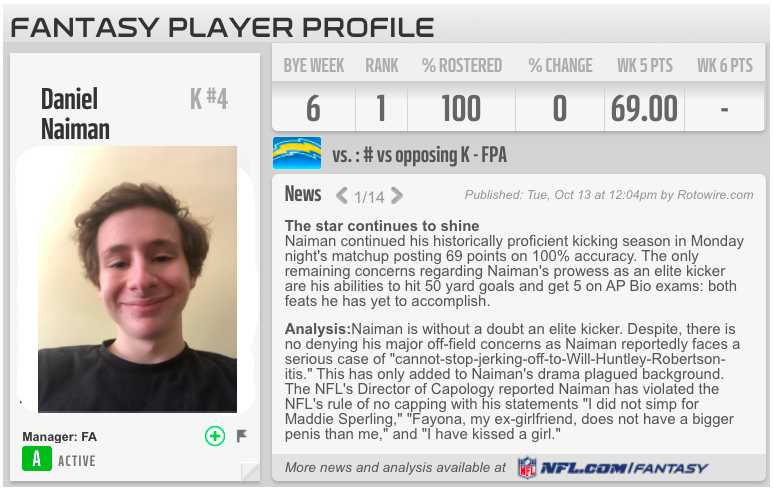

In [71]:
cv2_imshow(target);

Our cover image

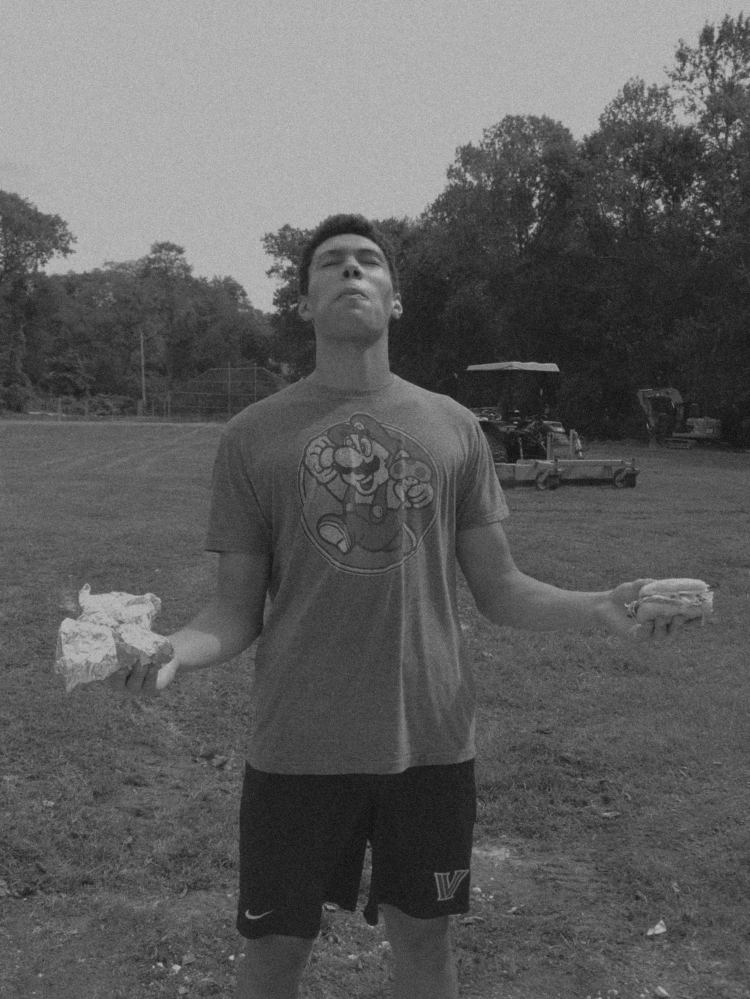

In [72]:
cv2_imshow(cover);

Now, let's encode the images . . .

In [73]:
hidden = encoder(target, cover)

What does the cover image carrying our target look like now?

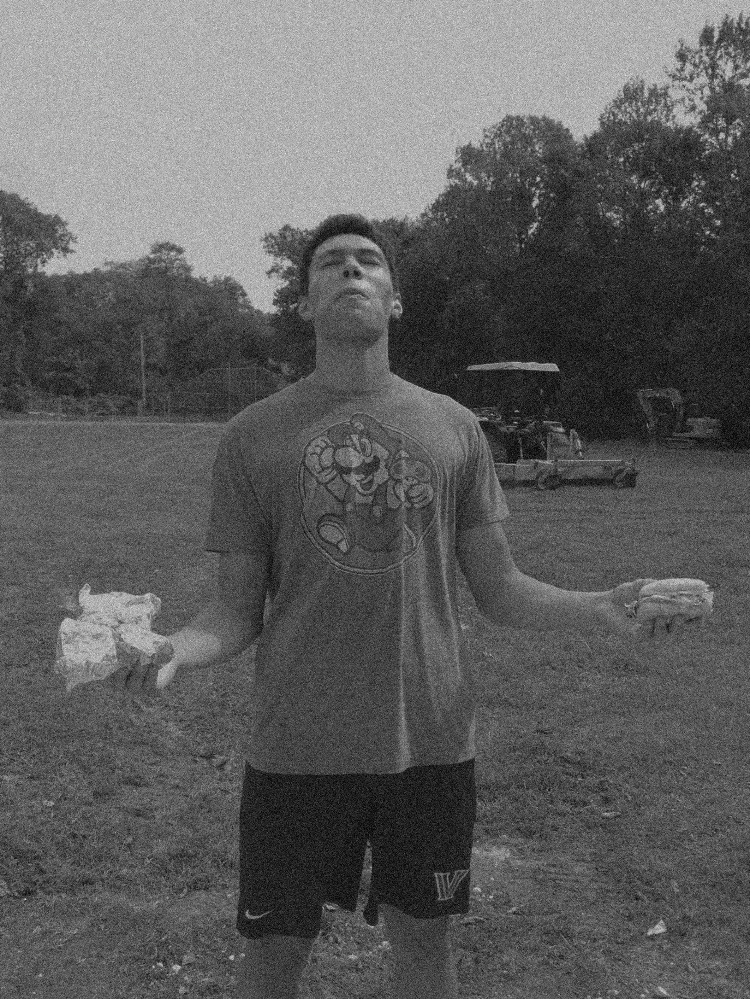

In [74]:
cv2_imshow(hidden)

Now to extract our hidden image . . .

In [75]:
extracted = decoder(hidden)

Now let's see how well our sercet image can be recovered!

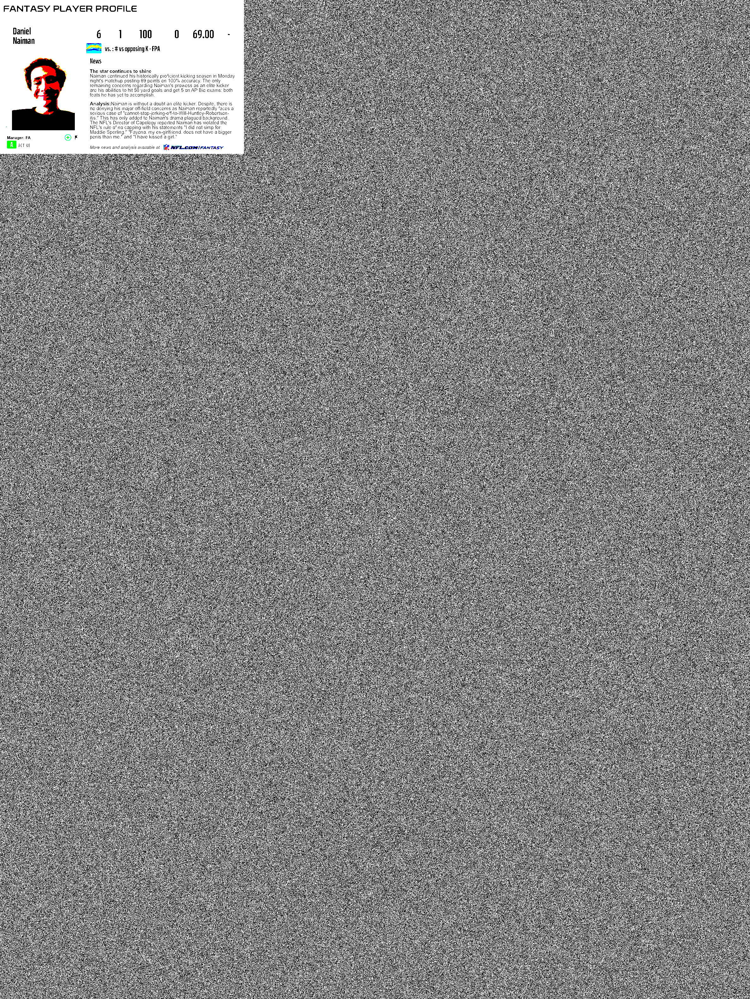

In [76]:
cv2_imshow(extracted)

Nice!